In [0]:
!git clone https://github.com/ritusingla/deep-image-prior
!mv deep-image-prior/* ./

Cloning into 'deep-image-prior'...
remote: Enumerating objects: 253, done.
remote: Counting objects: 100% (253/253), done.
remote: Compressing objects: 100% (209/209), done.
remote: Total 561 (delta 79), reused 155 (delta 43), pack-reused 308
Receiving objects: 100% (561/561), 279.39 MiB | 19.56 MiB/s, done.
Resolving deltas: 100% (242/242), done.


# Import libs

In [0]:
from __future__ import print_function
import matplotlib.pyplot as plt
%matplotlib inline

import os
# os.environ['CUDA_VISIBLE_DEVICES'] = '1'

import numpy as np
from models.resnet import ResNet
from models.unet import UNet
from models.skip import skip
import torch
import torch.optim

from utils.inpainting_utils import *

torch.backends.cudnn.enabled = True
torch.backends.cudnn.benchmark =True
dtype = torch.cuda.FloatTensor

PLOT = True
imsize = -1
dim_div_by = 64

# Choose figure

In [0]:
## Fig 6
# img_path  = 'data/inpainting/vase.png'
# mask_path = 'data/inpainting/vase_mask.png'

## Fig 8
# img_path  = 'data/inpainting/library.png'
# mask_path = 'data/inpainting/library_mask.png'

## Fig 7 (top)
img_path  = 'data/inpainting/kate.png'
mask_path = 'data/inpainting/kate_mask.png'

# Another text inpainting example
# img_path  = 'data/inpainting/peppers.png'
# mask_path = 'data/inpainting/peppers_mask.png'

NET_TYPE = 'skip_depth6' # one of skip_depth4|skip_depth2|UNET|ResNet

# Load mask

In [0]:
img_pil, img_np = get_image(img_path, imsize)
img_mask_pil, img_mask_np = get_image(mask_path, imsize)

### Center crop

In [0]:
img_mask_pil = crop_image(img_mask_pil, dim_div_by)
img_pil      = crop_image(img_pil,      dim_div_by)

img_np      = pil_to_np(img_pil)
img_mask_np = pil_to_np(img_mask_pil)

### Visualize

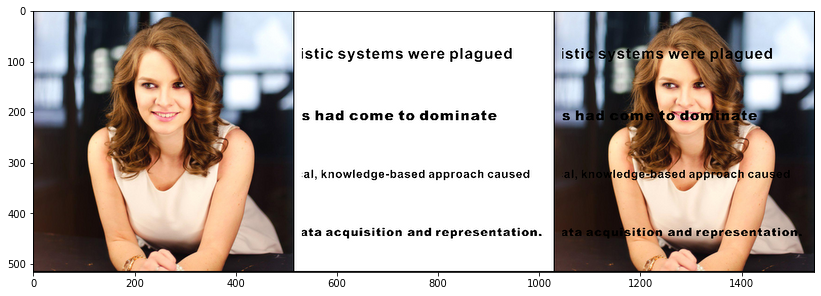

In [0]:
img_mask_var = np_to_torch(img_mask_np).type(dtype)

plot_image_grid([img_np, img_mask_np, img_mask_np*img_np], 3,11);

# Setup

In [0]:
pad = 'reflection' # 'zero'
OPT_OVER = 'net'
OPTIMIZER = 'adam'

In [0]:
if 'vase.png' in img_path:
    INPUT = 'meshgrid'
    input_depth = 2
    LR = 0.01 
    num_iter = 5001
    param_noise = False
    show_every = 50
    figsize = 5
    reg_noise_std = 0.03
    
    net = skip(input_depth, img_np.shape[0], 
               num_channels_down = [128] * 5,
               num_channels_up   = [128] * 5,
               num_channels_skip = [0] * 5,  
               upsample_mode='nearest', filter_skip_size=1, filter_size_up=3, filter_size_down=3,
               need_sigmoid=True, need_bias=True, pad=pad, act_fun='LeakyReLU').type(dtype)
    
elif ('kate.png' in img_path) or ('peppers.png' in img_path):
    # Same params and net as in super-resolution and denoising
    INPUT = 'noise'
    input_depth = 32
    LR = 0.01 
    num_iter = 6001
    param_noise = False
    show_every = 50
    figsize = 5
    reg_noise_std = 0.03
    
    net = skip(input_depth, img_np.shape[0], 
               num_channels_down = [128] * 5,
               num_channels_up =   [128] * 5,
               num_channels_skip =    [128] * 5,  
               filter_size_up = 3, filter_size_down = 3, 
               upsample_mode='nearest', filter_skip_size=1,
               need_sigmoid=True, need_bias=True, pad=pad, act_fun='LeakyReLU').type(dtype)
    
elif 'library.png' in img_path:
    
    INPUT = 'noise'
    input_depth = 1
    
    num_iter = 3001
    show_every = 50
    figsize = 8
    reg_noise_std = 0.00
    param_noise = True
    
    if 'skip' in NET_TYPE:
        
        depth = int(NET_TYPE[-1])
        net = skip(input_depth, img_np.shape[0], 
               num_channels_down = [16, 32, 64, 128, 128, 128][:depth],
               num_channels_up =   [16, 32, 64, 128, 128, 128][:depth],
               num_channels_skip =    [0, 0, 0, 0, 0, 0][:depth],  
               filter_size_up = 3,filter_size_down = 5,  filter_skip_size=1,
               upsample_mode='nearest', # downsample_mode='avg',
               need1x1_up=False,
               need_sigmoid=True, need_bias=True, pad=pad, act_fun='LeakyReLU').type(dtype)
        
        LR = 0.01 
        
    elif NET_TYPE == 'UNET':
        
        net = UNet(num_input_channels=input_depth, num_output_channels=3, 
                   feature_scale=8, more_layers=1, 
                   concat_x=False, upsample_mode='deconv', 
                   pad='zero', norm_layer=torch.nn.InstanceNorm2d, need_sigmoid=True, need_bias=True)
        
        LR = 0.001
        param_noise = False
        
    elif NET_TYPE == 'ResNet':
        
        net = ResNet(input_depth, img_np.shape[0], 8, 32, need_sigmoid=True, act_fun='LeakyReLU')
        
        LR = 0.001
        param_noise = False
        
    else:
        assert False
else:
    assert False

net = net.type(dtype)
net_input = get_noise(input_depth, INPUT, img_np.shape[1:]).type(dtype)

In [0]:
# Compute number of parameters
s  = sum(np.prod(list(p.size())) for p in net.parameters())
print ('Number of params: %d' % s)

# Loss
mse = torch.nn.MSELoss().type(dtype)

img_var = np_to_torch(img_np).type(dtype)
mask_var = np_to_torch(img_mask_np).type(dtype)

Number of params: 3002627


# Main loop

Starting optimization with ADAM
Iteration 00000    Loss 0.119752

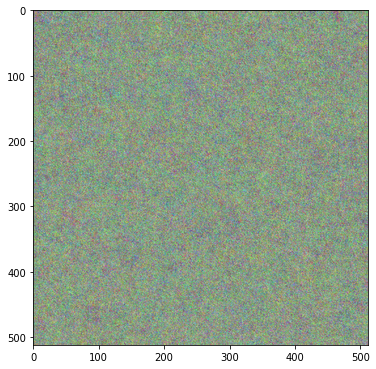

Iteration 00050    Loss 0.016125

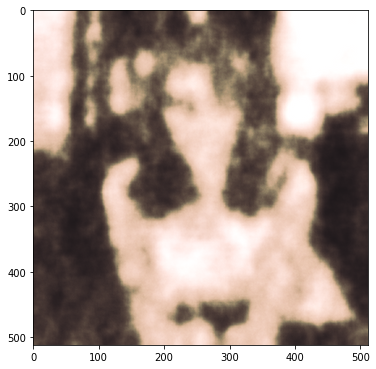

Iteration 00100    Loss 0.010322

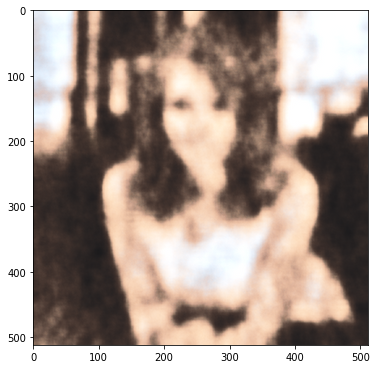

Iteration 00150    Loss 0.005819

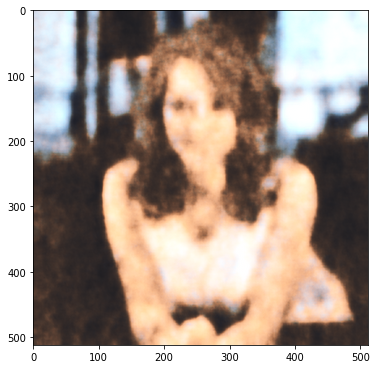

Iteration 00200    Loss 0.004675

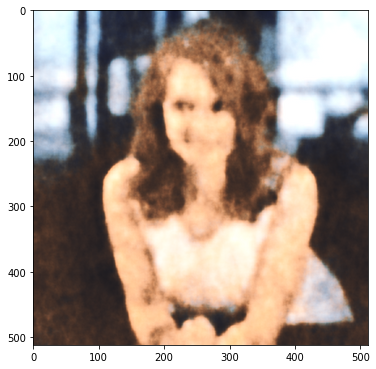

Iteration 00250    Loss 0.003553

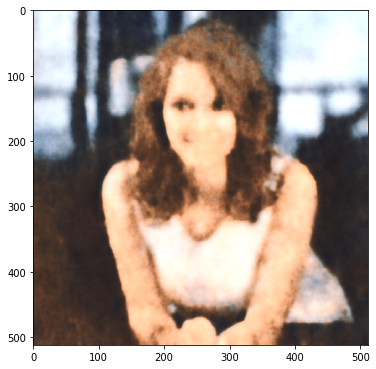

Iteration 00300    Loss 0.002849

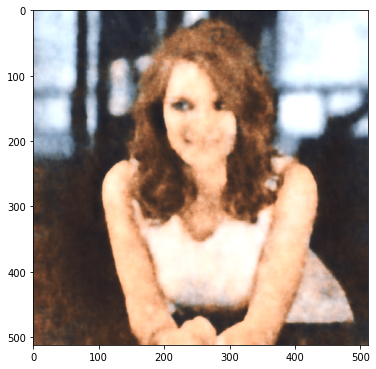

Iteration 00350    Loss 0.002230

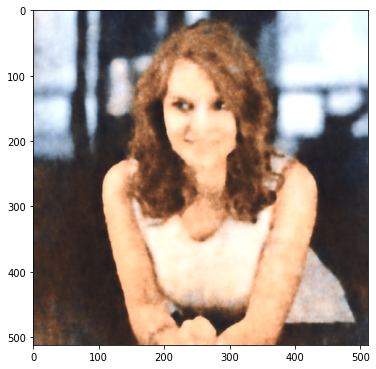

Iteration 00400    Loss 0.001895

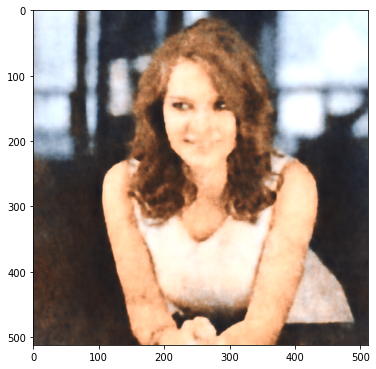

Iteration 00450    Loss 0.001678

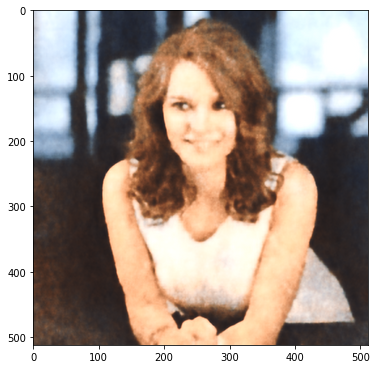

Iteration 00500    Loss 0.001513

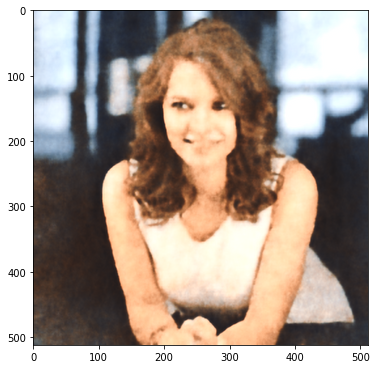

Iteration 00550    Loss 0.001353

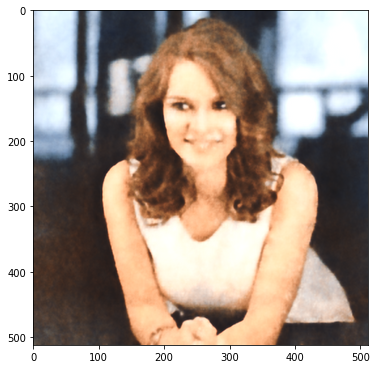

Iteration 00600    Loss 0.001307

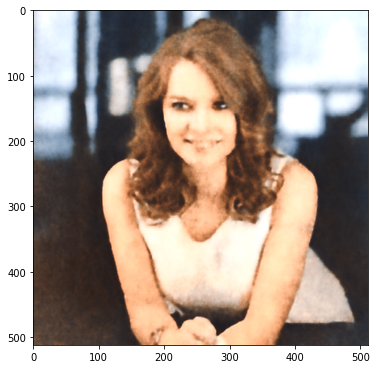

Iteration 00650    Loss 0.001110

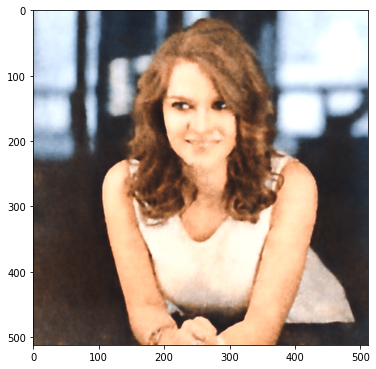

Iteration 00700    Loss 0.001063

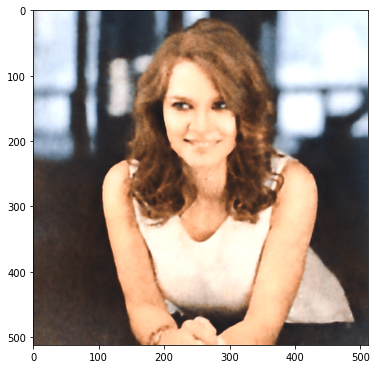

Iteration 00750    Loss 0.000976

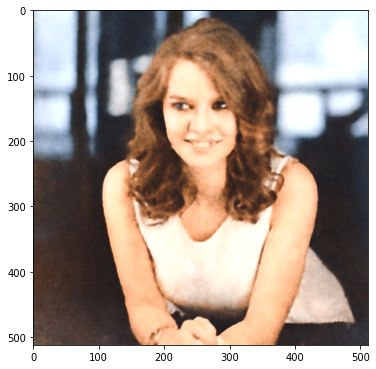

Iteration 00800    Loss 0.000905

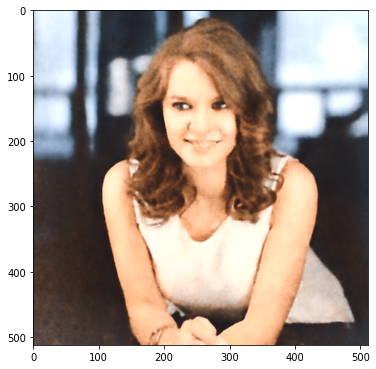

Iteration 00850    Loss 0.000905

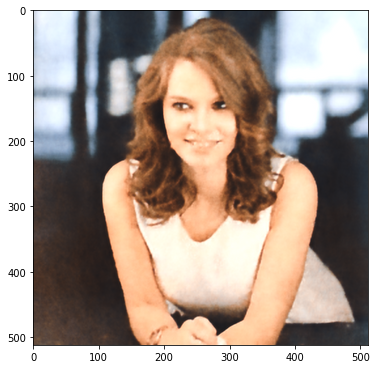

Iteration 00900    Loss 0.000862

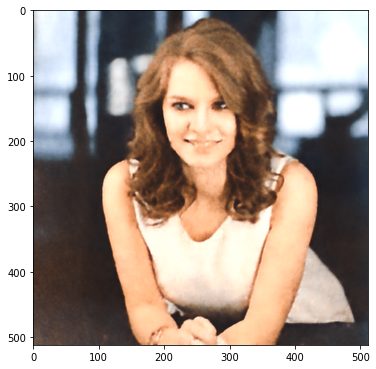

Iteration 00950    Loss 0.000802

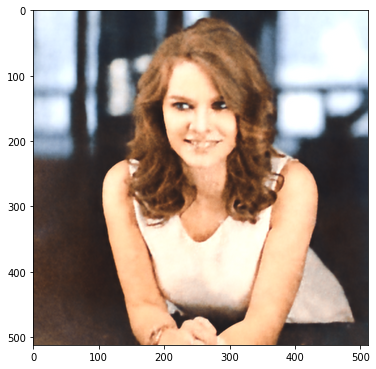

Iteration 01000    Loss 0.000717

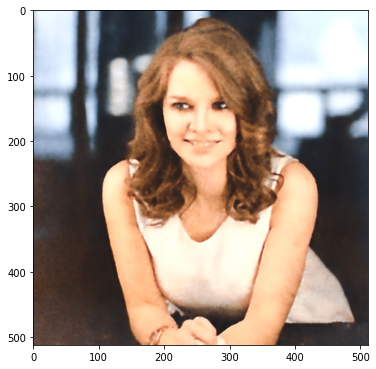

Iteration 01050    Loss 0.000690

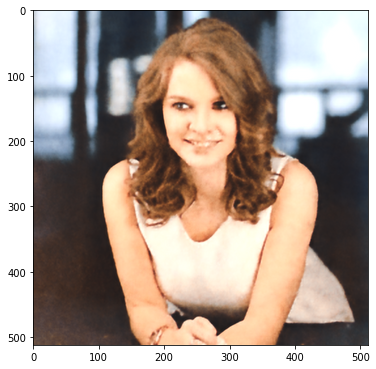

Iteration 01100    Loss 0.000643

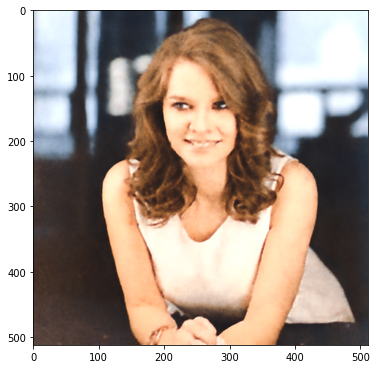

Iteration 01150    Loss 0.000637

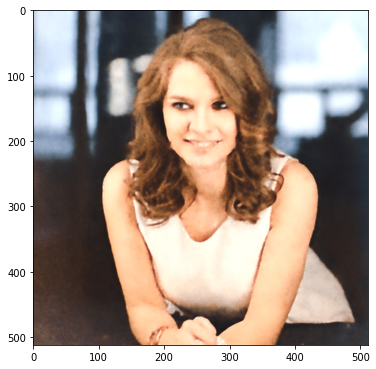

Iteration 01200    Loss 0.000628

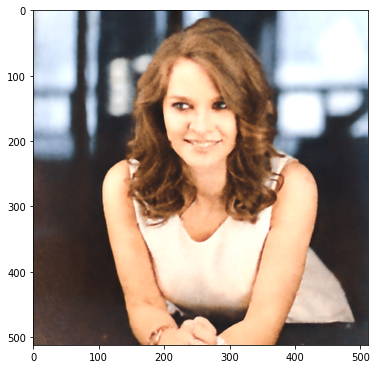

Iteration 01250    Loss 0.000585

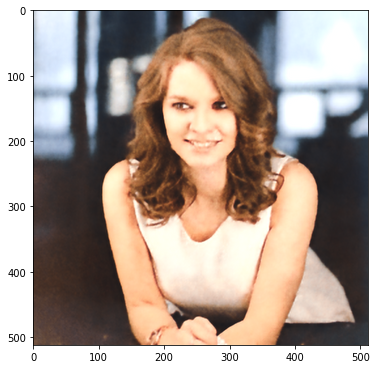

Iteration 01300    Loss 0.000605

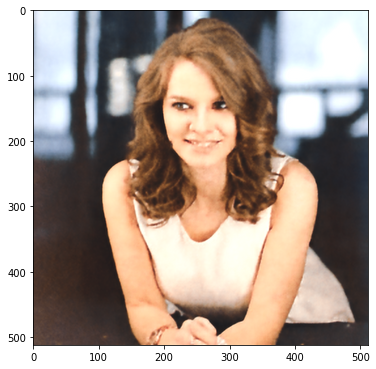

Iteration 01350    Loss 0.000542

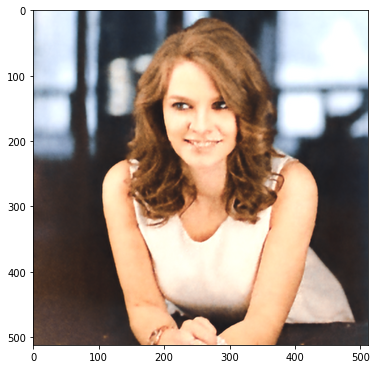

Iteration 01400    Loss 0.000546

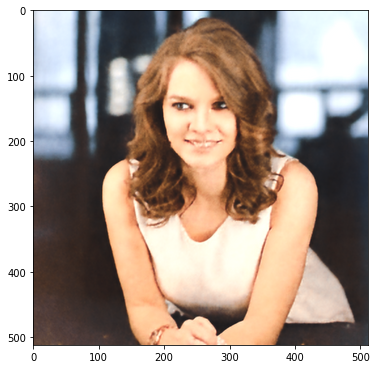

Iteration 01450    Loss 0.000510

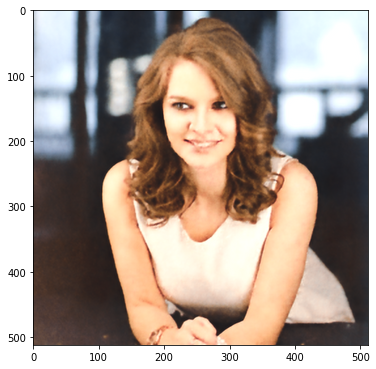

Iteration 01500    Loss 0.000515

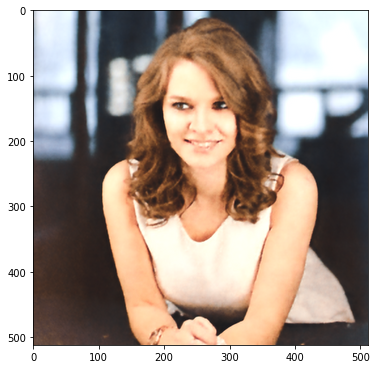

Iteration 01550    Loss 0.000457

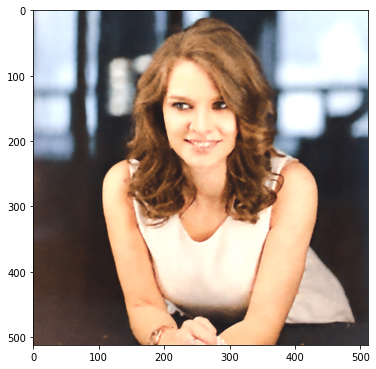

Iteration 01600    Loss 0.000461

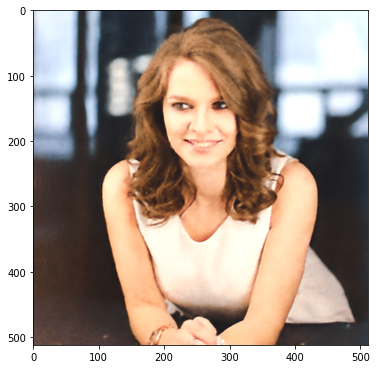

Iteration 01650    Loss 0.000503

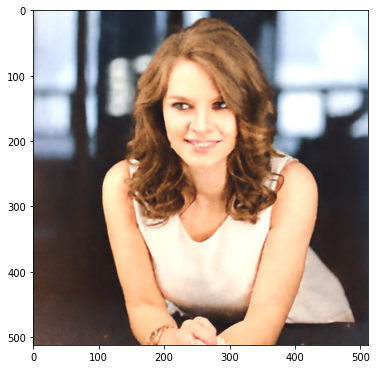

Iteration 01700    Loss 0.000442

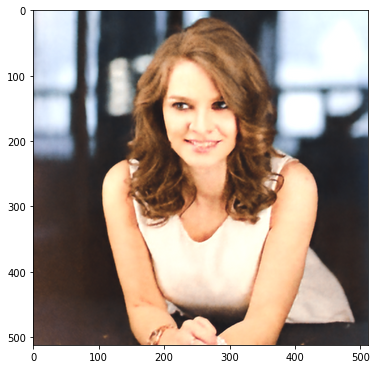

Iteration 01750    Loss 0.000416

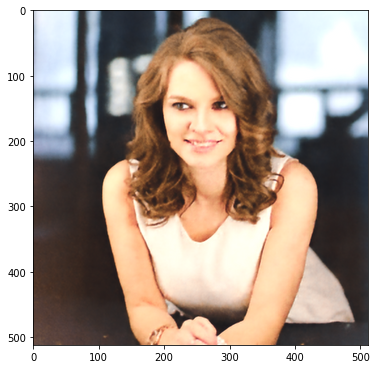

Iteration 01800    Loss 0.000447

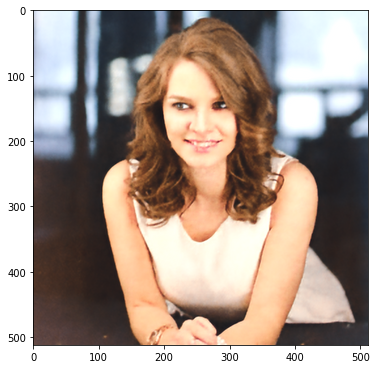

Iteration 01850    Loss 0.000399

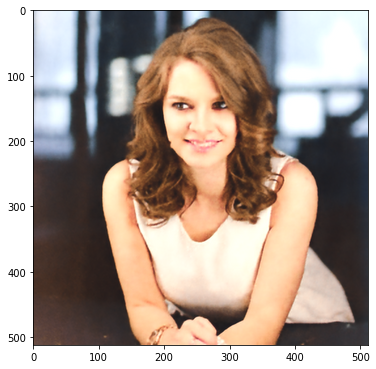

Iteration 01900    Loss 0.000391

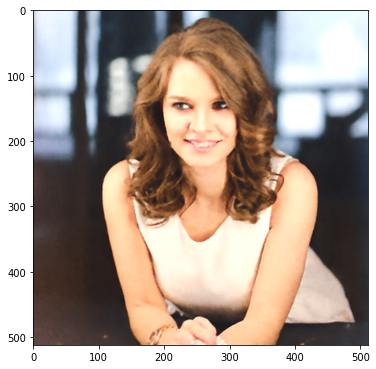

Iteration 01950    Loss 0.000381

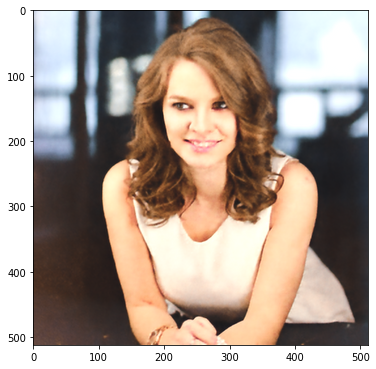

Iteration 02000    Loss 0.000373

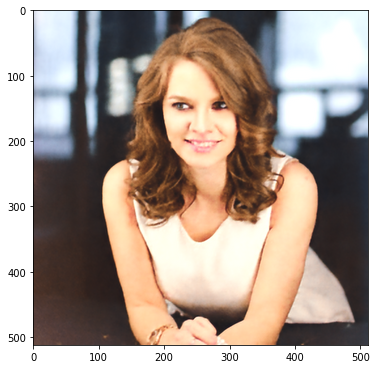

Iteration 02050    Loss 0.000360

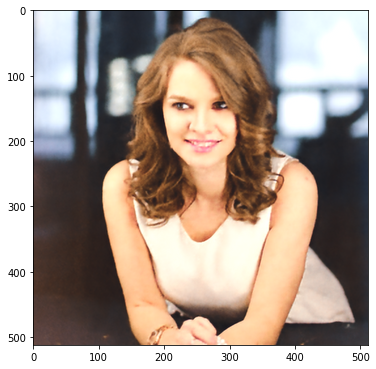

Iteration 02100    Loss 0.000385

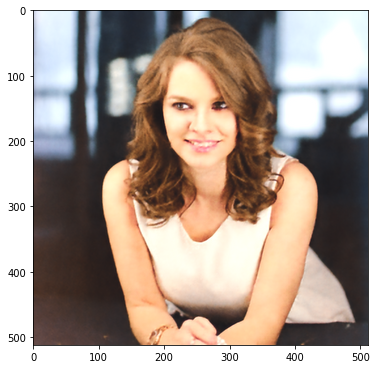

Iteration 02150    Loss 0.000352

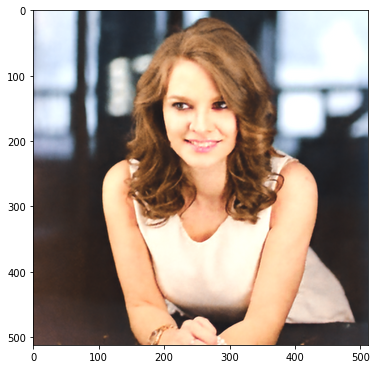

Iteration 02200    Loss 0.000357

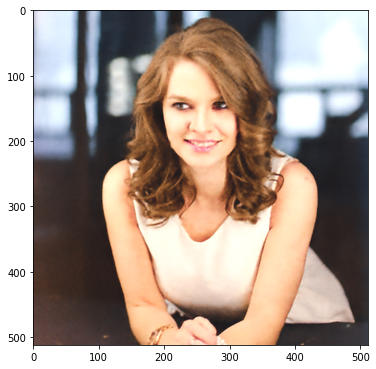

Iteration 02250    Loss 0.000332

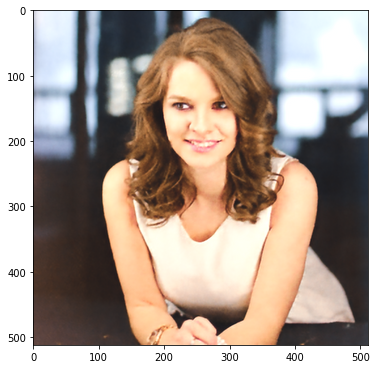

Iteration 02300    Loss 0.000320

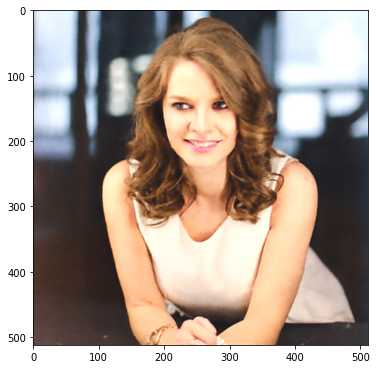

Iteration 02350    Loss 0.000314

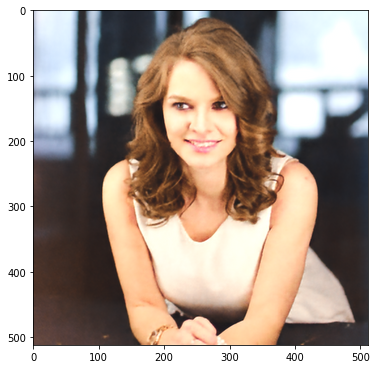

Iteration 02400    Loss 0.000309

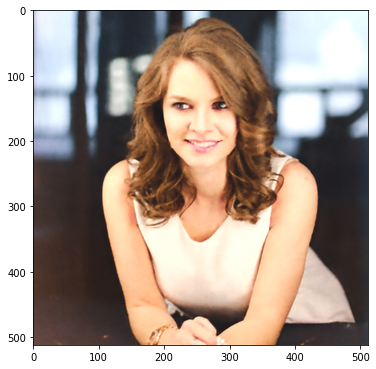

Iteration 02450    Loss 0.000303

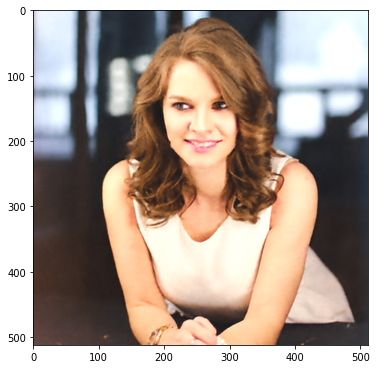

Iteration 02500    Loss 0.000296

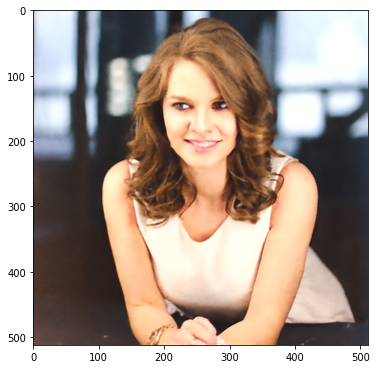

Iteration 02550    Loss 0.000380

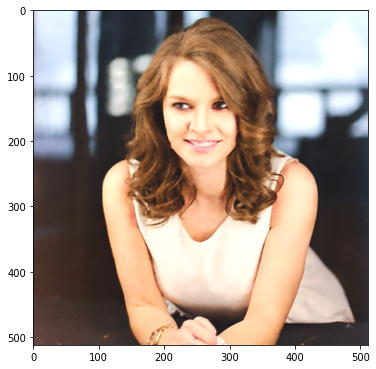

Iteration 02600    Loss 0.000290

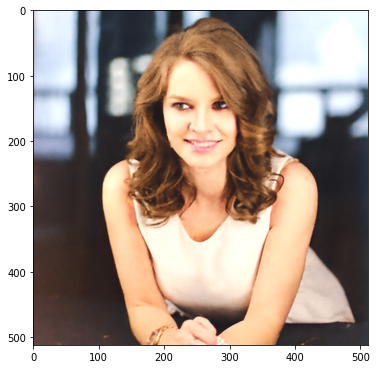

Iteration 02650    Loss 0.000301

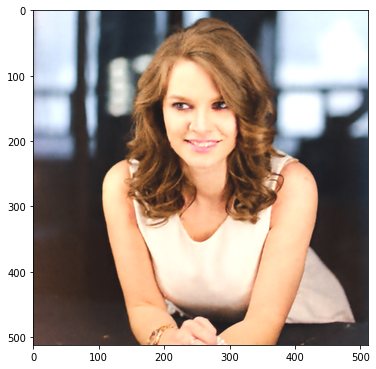

Iteration 02700    Loss 0.000278

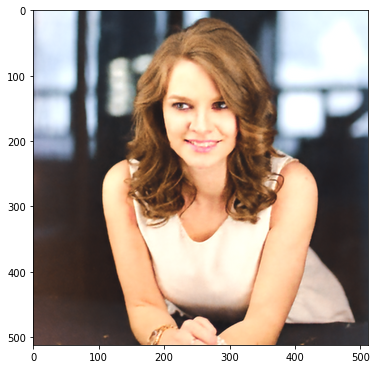

Iteration 02750    Loss 0.000272

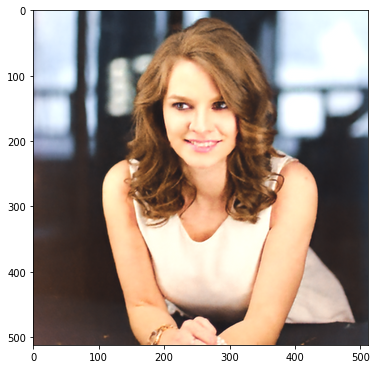

Iteration 02800    Loss 0.000295

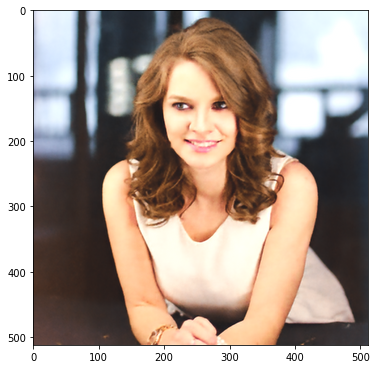

Iteration 02850    Loss 0.000265

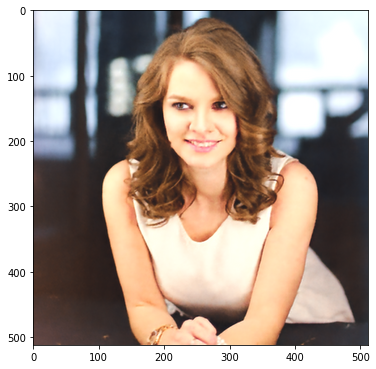

Iteration 02900    Loss 0.000274

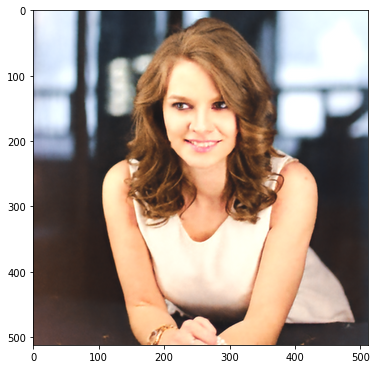

Iteration 02950    Loss 0.000258

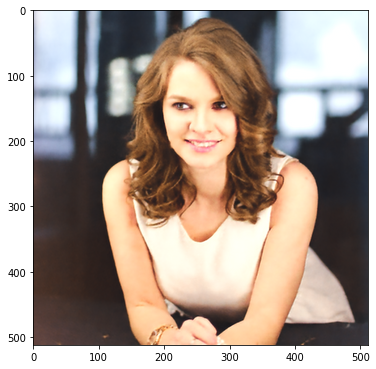

Iteration 03000    Loss 0.000296

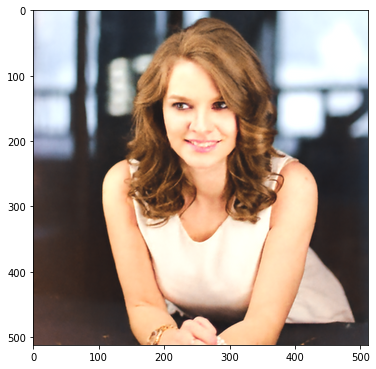

Iteration 03050    Loss 0.000248

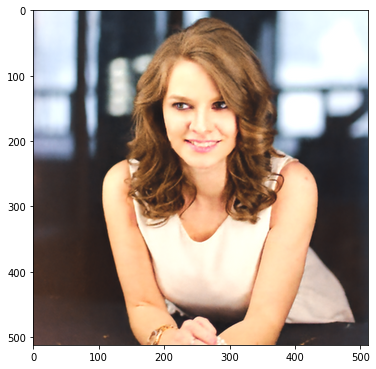

Iteration 03100    Loss 0.000246

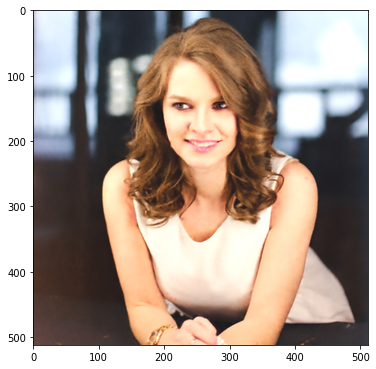

Iteration 03150    Loss 0.000253

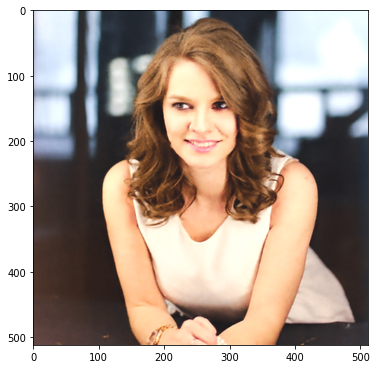

Iteration 03200    Loss 0.000249

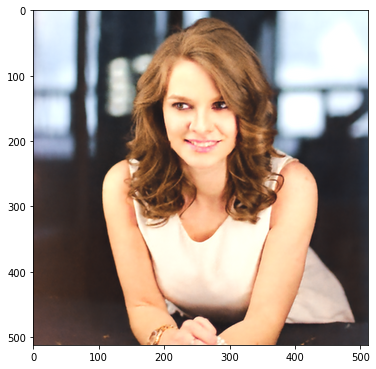

Iteration 03250    Loss 0.000220

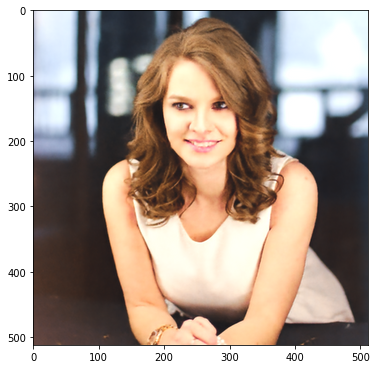

Iteration 03300    Loss 0.000223

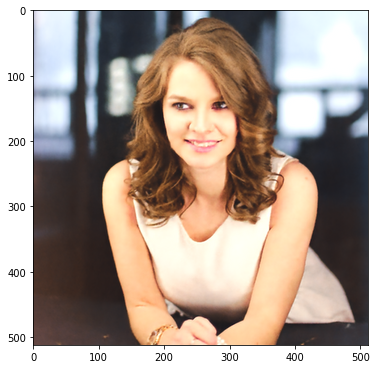

Iteration 03350    Loss 0.000238

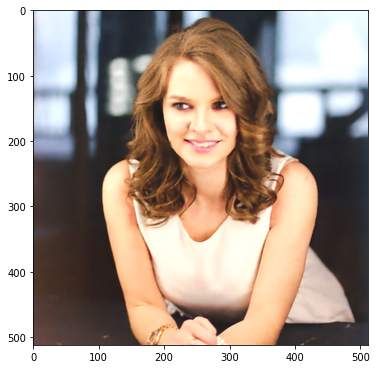

Iteration 03400    Loss 0.000212

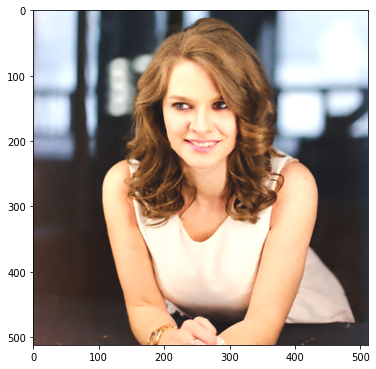

Iteration 03450    Loss 0.000234

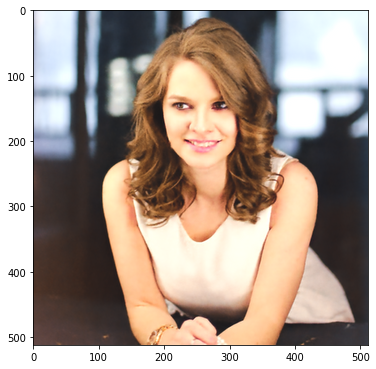

Iteration 03500    Loss 0.000225

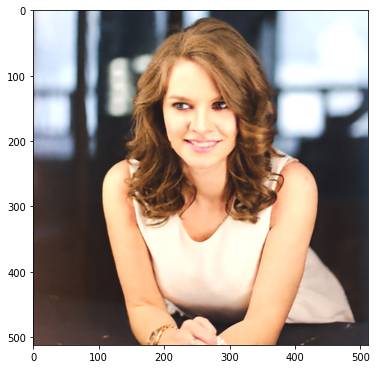

Iteration 03550    Loss 0.000229

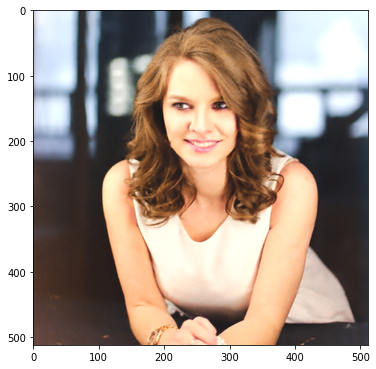

Iteration 03600    Loss 0.000201

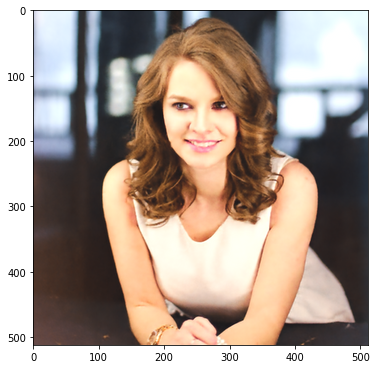

Iteration 03650    Loss 0.000215

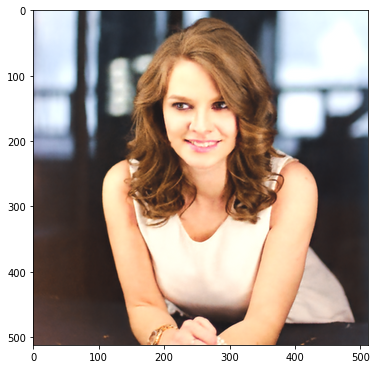

Iteration 03700    Loss 0.000211

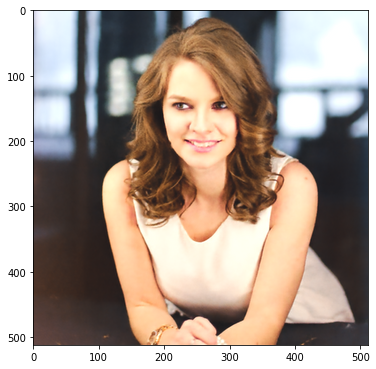

Iteration 03750    Loss 0.000195

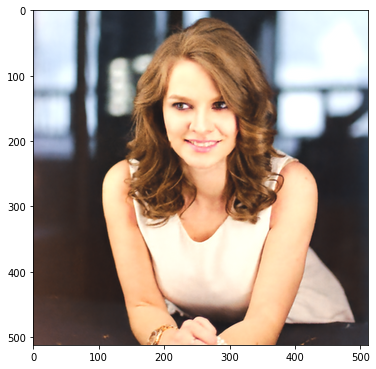

Iteration 03800    Loss 0.000211

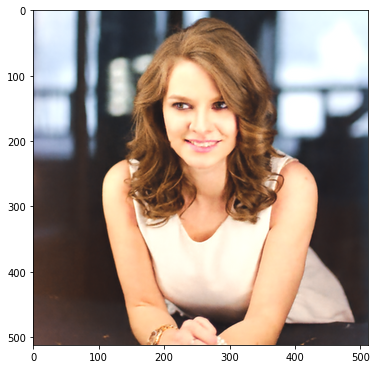

Iteration 03850    Loss 0.000194

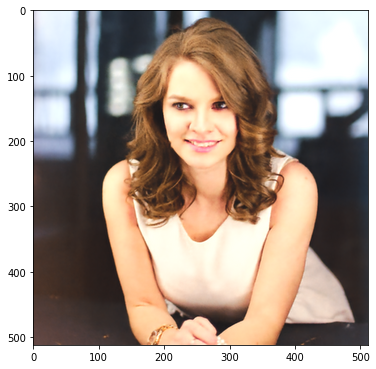

Iteration 03900    Loss 0.000207

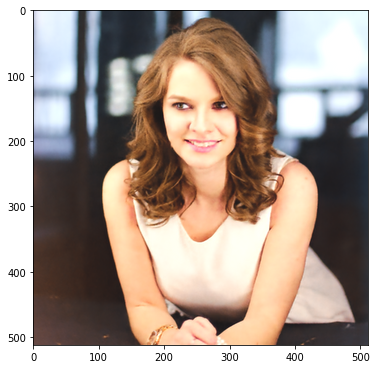

Iteration 03950    Loss 0.000178

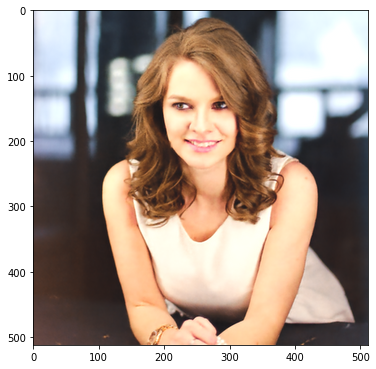

Iteration 04000    Loss 0.000175

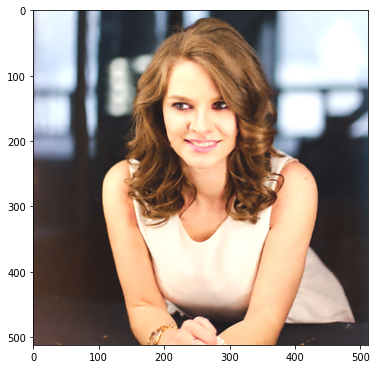

Iteration 04050    Loss 0.000185

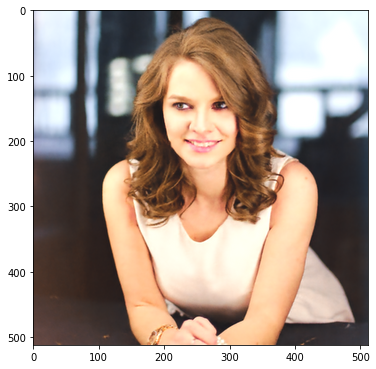

Iteration 04100    Loss 0.000181

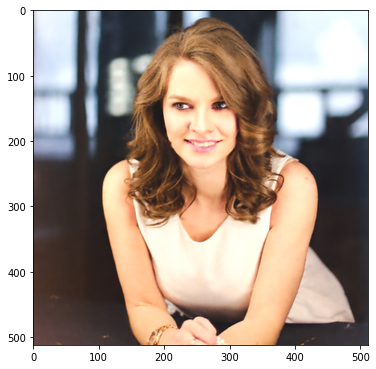

Iteration 04150    Loss 0.000174

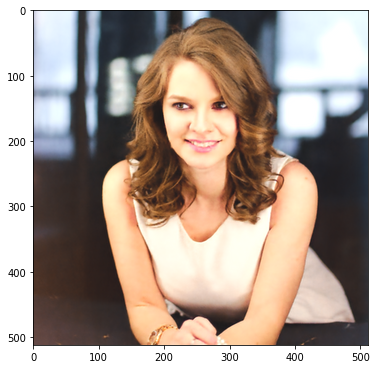

Iteration 04200    Loss 0.000172

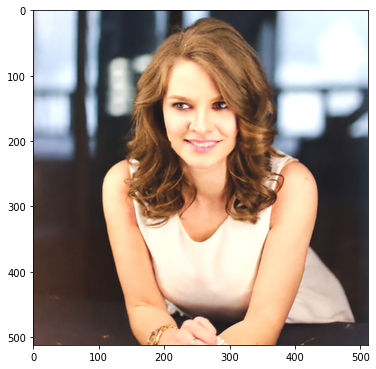

Iteration 04250    Loss 0.000171

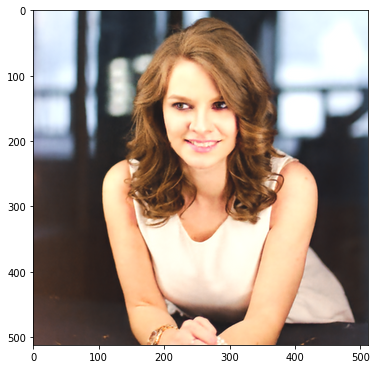

Iteration 04300    Loss 0.000161

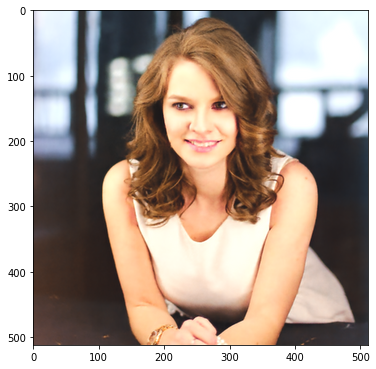

Iteration 04350    Loss 0.000200

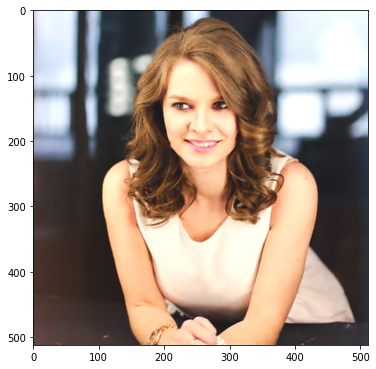

Iteration 04400    Loss 0.000186

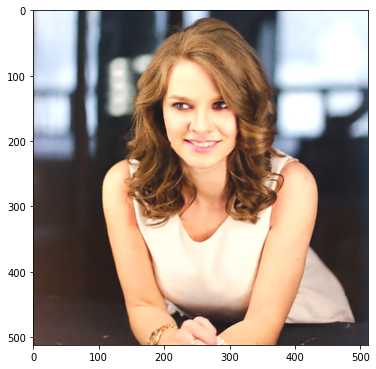

Iteration 04450    Loss 0.000160

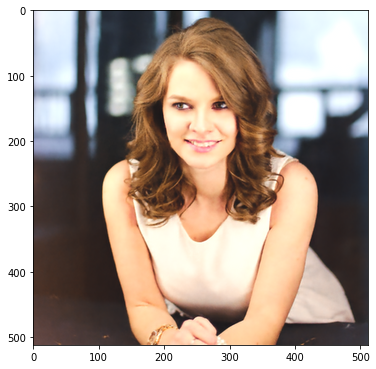

Iteration 04500    Loss 0.000180

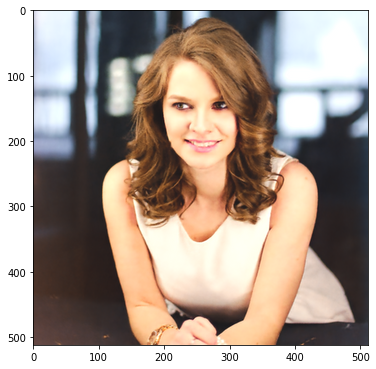

Iteration 04550    Loss 0.000155

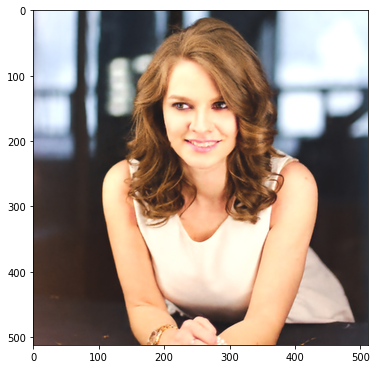

Iteration 04600    Loss 0.000150

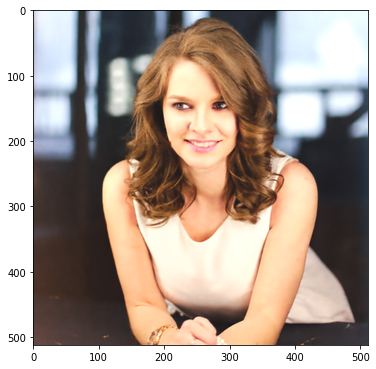

Iteration 04650    Loss 0.000155

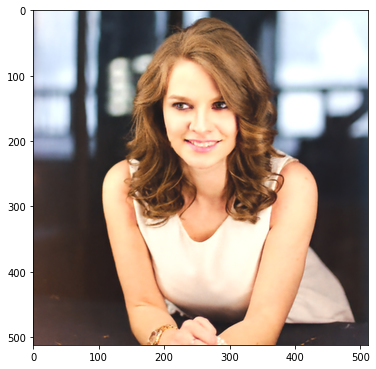

Iteration 04700    Loss 0.000168

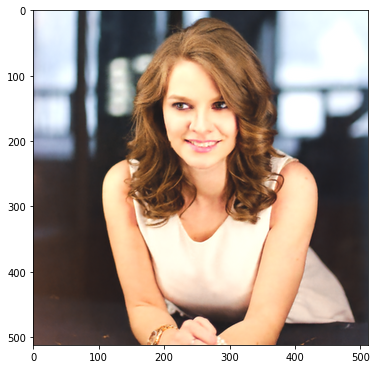

Iteration 04750    Loss 0.000149

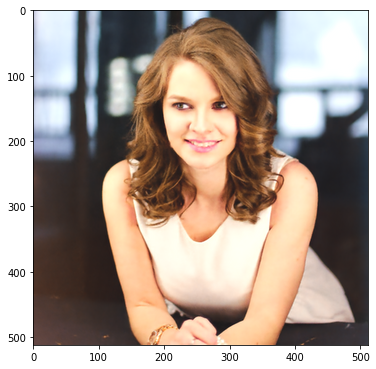

Iteration 04800    Loss 0.000170

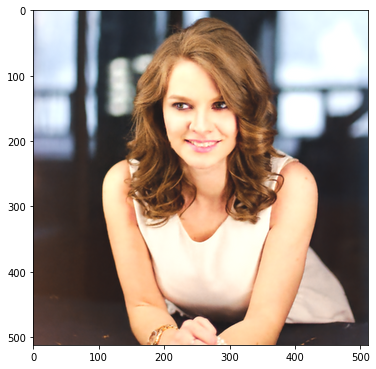

Iteration 04850    Loss 0.000173

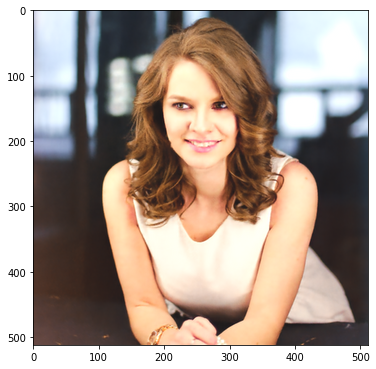

Iteration 04900    Loss 0.000138

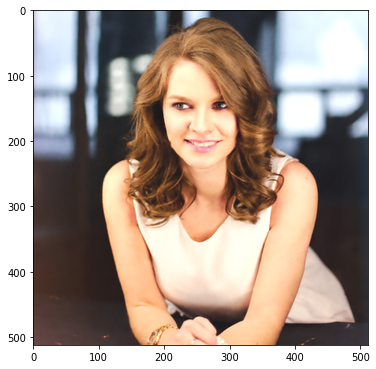

Iteration 04950    Loss 0.000145

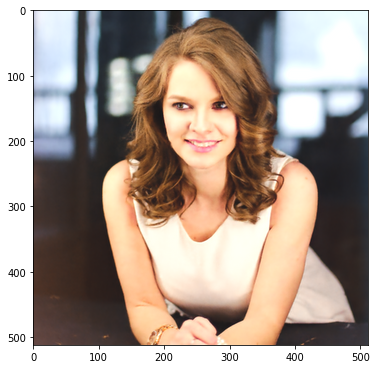

Iteration 05000    Loss 0.000158

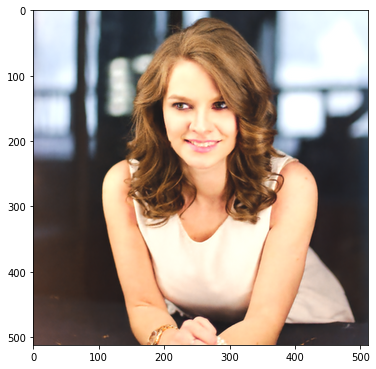

Iteration 05050    Loss 0.000147

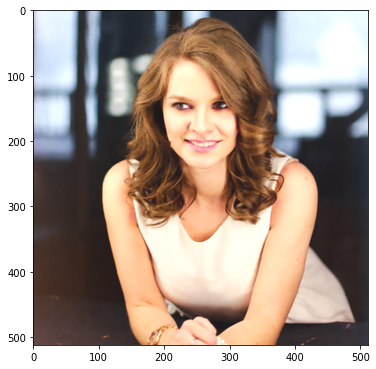

Iteration 05100    Loss 0.000148

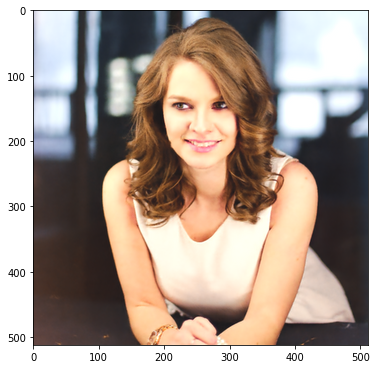

Iteration 05150    Loss 0.000138

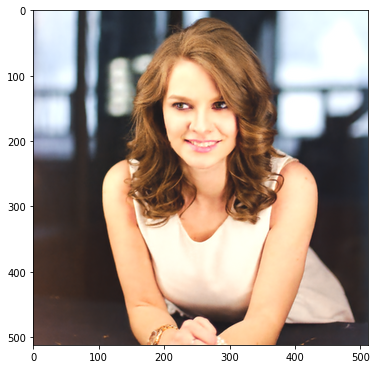

Iteration 05200    Loss 0.000135

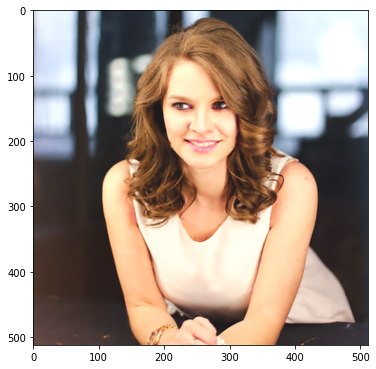

Iteration 05250    Loss 0.000142

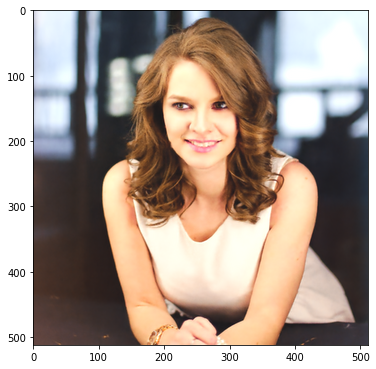

Iteration 05300    Loss 0.000130

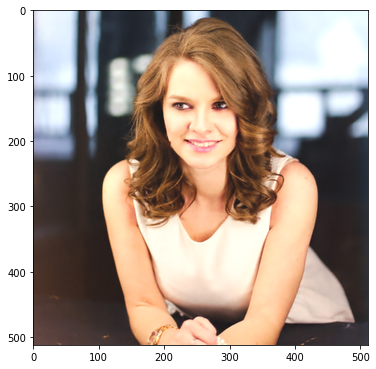

Iteration 05350    Loss 0.000138

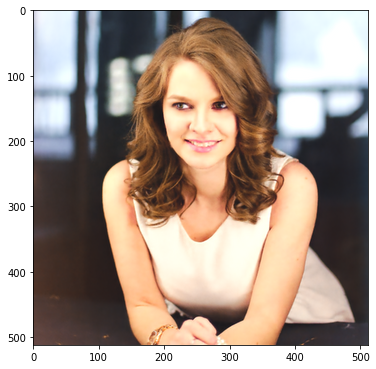

Iteration 05400    Loss 0.000155

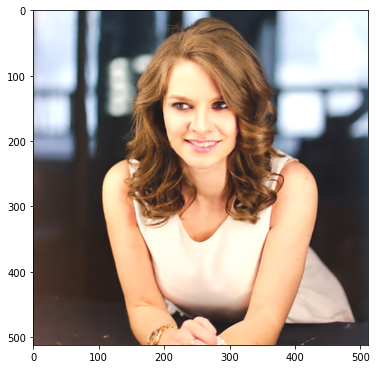

Iteration 05450    Loss 0.000122

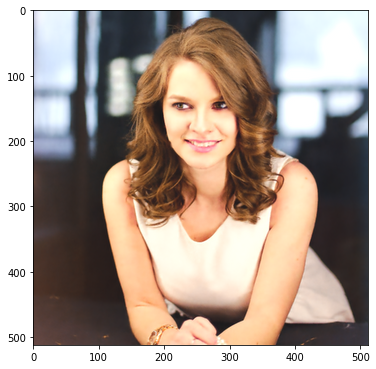

Iteration 05500    Loss 0.000132

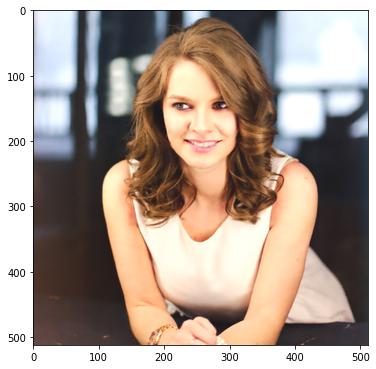

Iteration 05550    Loss 0.000117

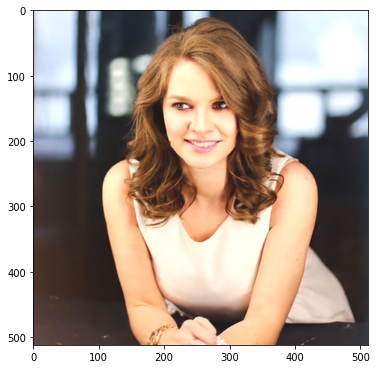

Iteration 05600    Loss 0.000119

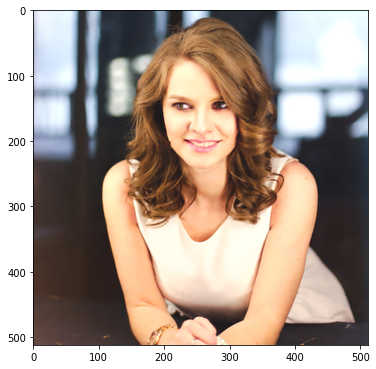

Iteration 05650    Loss 0.000111

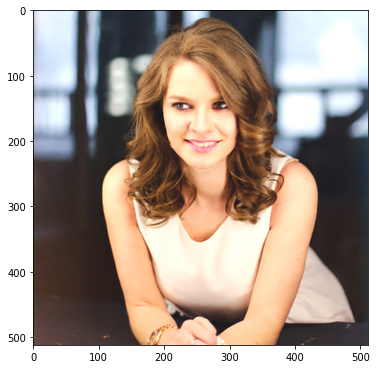

Iteration 05700    Loss 0.000117

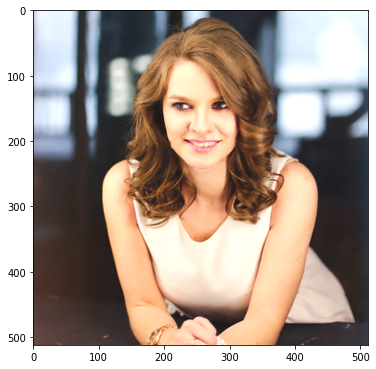

Iteration 05750    Loss 0.000113

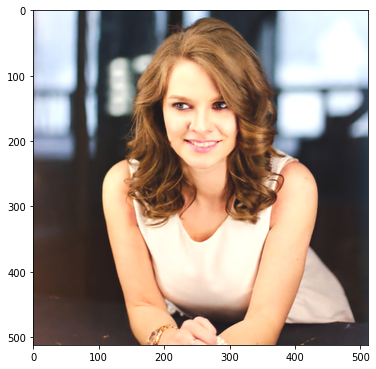

Iteration 05800    Loss 0.000123

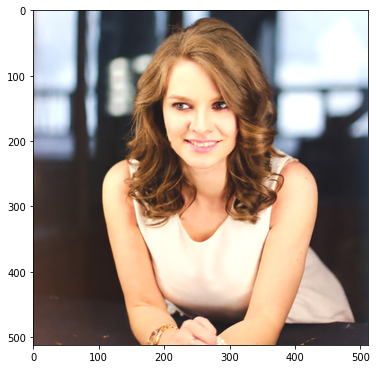

Iteration 05850    Loss 0.000131

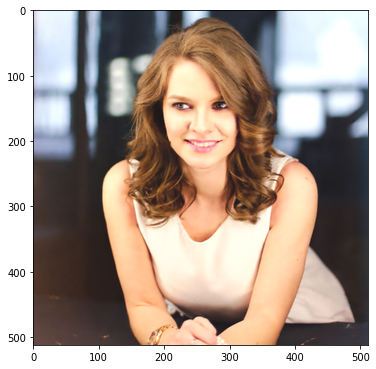

Iteration 05900    Loss 0.000118

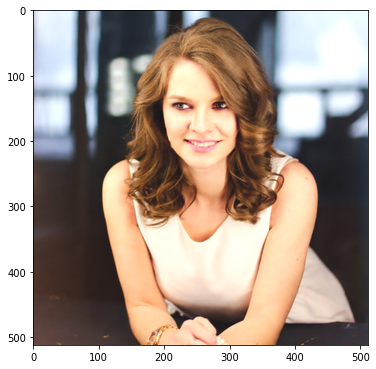

Iteration 05950    Loss 0.000124

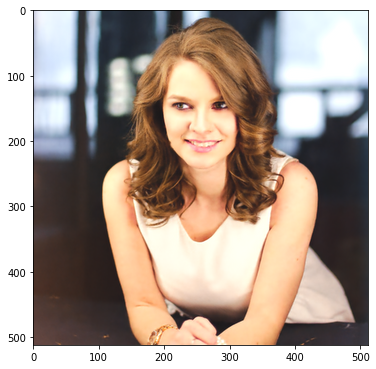

Iteration 06000    Loss 0.000111

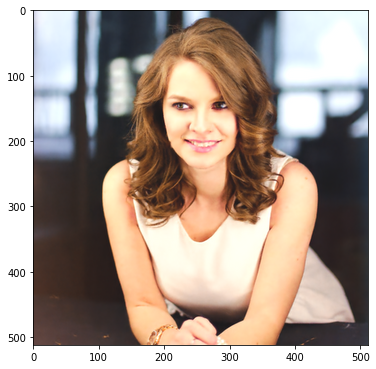

In [0]:
i = 0
loss=[]
acc=[]
def closure():
    
    global i,loss,acc
    
    if param_noise:
        for n in [x for x in net.parameters() if len(x.size()) == 4]:
            n = n + n.detach().clone().normal_() * n.std() / 50
    
    net_input = net_input_saved
    if reg_noise_std > 0:
        net_input = net_input_saved + (noise.normal_() * reg_noise_std)
        
        
    out = net(net_input)
   
    total_loss = mse(out * mask_var, img_var * mask_var)
    total_loss.backward()
    loss=np.append(loss,total_loss.item())
    acc= np.append(acc,100-(total_loss.item()*1000))

    if  PLOT and i % show_every == 0:
        print ('Iteration %05d    Loss %f' % (i, total_loss.item()), sep='\n', end='')
        out_np = torch_to_np(out)
        plot_image_grid([np.clip(out_np+0.07, 0, 1)], factor=figsize, nrow=1)
        
    i += 1

    return total_loss

net_input_saved = net_input.detach().clone()
noise = net_input.detach().clone()

p = get_params(OPT_OVER, net, net_input)
optimize(OPTIMIZER, p, closure, LR, num_iter)

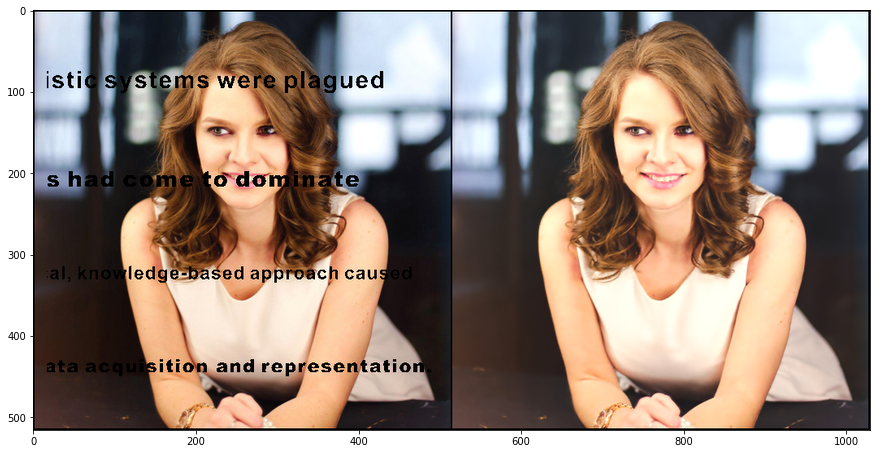

In [0]:
out_np = torch_to_np(net(net_input))
out=torch_to_np(net(net_input))+0.07
q = plot_image_grid([img_mask_np*img_np,np.clip(out, 0, 1)], factor=13,nrow=3);

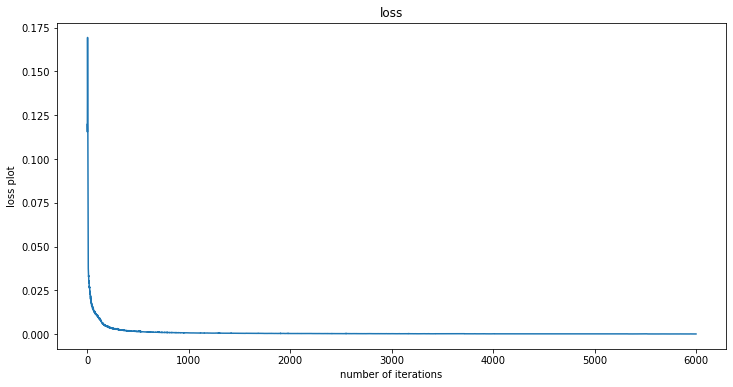

In [0]:
plt.title('loss')
plt.xlabel('number of iterations')
plt.ylabel('loss plot')
plt.plot(loss)
plt.show()

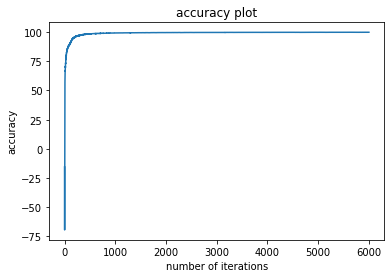

In [0]:
plt.xlabel('number of iterations')
plt.ylabel('accuracy')
acc=acc[1:]
plt.title('accuracy plot')
plt.plot(acc)
plt.show()

## Detailed Color Enhancement

In [0]:
!apt install caffe-cuda

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following additional packages will be installed:
  caffe-tools-cuda cython3 fonts-lyx javascript-common libblosc1
  libcaffe-cuda1 libcublas9.1 libcudart9.1 libcurand9.1 libgflags2.2
  libgoogle-glog0v5 libjs-jquery libjs-jquery-ui libleveldb1v5 liblmdb0
  python-matplotlib-data python-tables-data python3-bs4 python3-caffe-cuda
  python3-chardet python3-cycler python3-dateutil python3-decorator
  python3-gflags python3-h5py python3-html5lib python3-ipython
  python3-ipython-genutils python3-leveldb python3-lxml python3-matplotlib
  python3-networkx python3-nose python3-numexpr python3-olefile python3-pandas
  python3-pandas-lib python3-pexpect python3-pickleshare python3-pil
  python3-pkg-resources python3-prompt-toolkit python3-protobuf
  python3-ptyprocess python3-pygments python3-pyparsing python3-pywt
  python3-scipy python3-simplegeneric python3-six python3-skimage
  python3-skimage

In [0]:
import numpy as np
import matplotlib.pyplot as plt
import caffe
import os
import skimage.color as color
import scipy.ndimage.interpolation as sni

%matplotlib inline
plt.rcParams['figure.figsize'] = (12, 6)

In [0]:
!wget -O models/colorization_release_v1.caffemodel http://eecs.berkeley.edu/~rich.zhang/projects/2016_colorization/files/demo_v1/colorization_release_v1.caffemodel

--2020-06-01 02:01:51--  http://eecs.berkeley.edu/~rich.zhang/projects/2016_colorization/files/demo_v1/colorization_release_v1.caffemodel
Resolving eecs.berkeley.edu (eecs.berkeley.edu)... 23.185.0.1, 2620:12a:8001::1
Connecting to eecs.berkeley.edu (eecs.berkeley.edu)|23.185.0.1|:80... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://people.eecs.berkeley.edu/~rich.zhang/projects/2016_colorization/files/demo_v1/colorization_release_v1.caffemodel [following]
--2020-06-01 02:01:51--  https://people.eecs.berkeley.edu/~rich.zhang/projects/2016_colorization/files/demo_v1/colorization_release_v1.caffemodel
Resolving people.eecs.berkeley.edu (people.eecs.berkeley.edu)... 128.32.189.73
Connecting to people.eecs.berkeley.edu (people.eecs.berkeley.edu)|128.32.189.73|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 128948189 (123M)
Saving to: ‘models/colorization_release_v1.caffemodel’

models/colorization 100%[===================

In [0]:
gpu_id = 0
caffe.set_mode_gpu()
caffe.set_device(gpu_id)
net = caffe.Net('models/colorization_deploy_v1.prototxt', 'models/colorization_release_v1.caffemodel', caffe.TEST)

(H_in,W_in) = net.blobs['data_l'].data.shape[2:] # get input shape
(H_out,W_out) = net.blobs['class8_ab'].data.shape[2:] # get output shape
net.blobs['Trecip'].data[...] = 6/np.log(10) # 1/T, set annealing temperature
    # (We found that we had introduced a factor of log(10). We will update the arXiv shortly.)

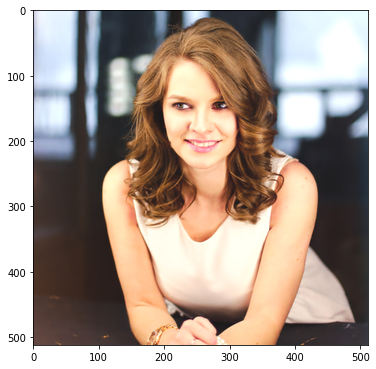

In [0]:
plot_image_grid([np.clip(out, 0, 1)], factor=figsize, nrow=1)
plt.show()


In [0]:

net.forward() # run network

out_HR_np = net.blobs['class8_ab'].data[0,:,:,:].transpose((1,2,0)) # this is our result


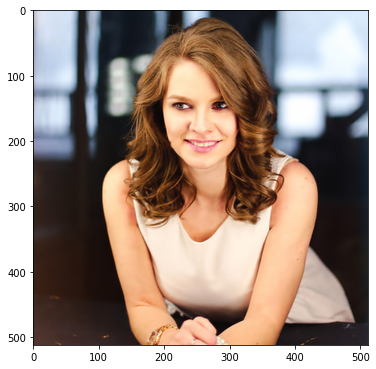

In [0]:
plot_image_grid([np.clip(out_np, 0, 1)], factor=figsize, nrow=1)
plt.show()

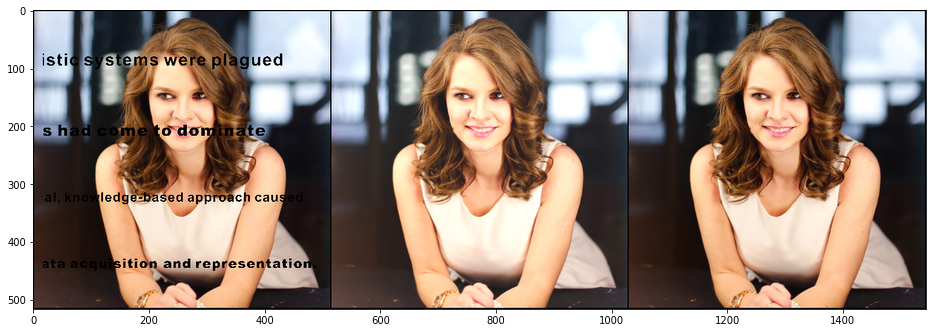

In [0]:
q = plot_image_grid([img_mask_np*img_np,np.clip(out, 0, 1),np.clip(out_np, 0, 1)], factor=13,nrow=3);